# RPM Tumor Time Series Velocity

In [234]:
# import mazebox as mb
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import sys
import dropkick as dk
# make sure to use position 1
sys.path.insert(1, "/Users/smgroves/Documents/GitHub/Groves-CellSys2021/")
import mazebox as mb
import cellrank as cr
import scanorama
from typing import Any
from copy import copy
from anndata import AnnData
import scipy.sparse as sp
from cellrank.tl.kernels import VelocityKernel
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

For CellRank:

In [4]:
class MyKernel(cr.tl.kernels.Kernel):
    def __init__(
        self, adata: AnnData, obs_key: str = "Diffusion Pseudotime", **kwargs: Any
    ):
        super().__init__(adata=adata, obs_key=obs_key, **kwargs)

    def _read_from_adata(self, obs_key: str, **kwargs: Any) -> None:
        super()._read_from_adata(**kwargs)

        print(f"Reading `adata.obs[{obs_key!r}]`")
        self.pseudotime = self.adata.obs[obs_key].values

    def compute_transition_matrix(self, some_parameter: float = 0.5) -> "MyKernel":
        print("Accessing `.pseudotime`: ", self.pseudotime)
        transition_matrix = sp.diags(
            (some_parameter,) * len(self.adata), dtype=np.float64
        )

        self._compute_transition_matrix(transition_matrix)

        return self

    def copy(self) -> "MyKernel":
        return copy(self)

In [12]:
adata = cr.read('../../out/RPM-time-series/adata_03b.h5ad')

/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `cellrank.tl.read` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  """Entry point for launching an IPython kernel.


In [13]:
adata

AnnData object with n_obs × n_vars = 15138 × 19455
    obs: 'Diffusion Pseudotime', 'Monocle Pseudotime', 'Clusters', '_X', '_Y', 'batch', 'doublet_scores', 'predicted_doublets', 'timepoint', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'barcode', 'ireland_barcode', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'specialists_pca_diffdist', 'SCLC-Y_Score', 'SCLC-P_Score', 'SCLC-N_Score', 'SCLC-A2_Score', 'SCLC-A_Score', 'Phenotype', 'SCLC-A_Score_pos', 'SCLC-A2_Score_pos', 'SCLC-N_Score_pos', 'SCLC-P_Score_pos', 'SCLC-Y_Score_pos', 'arc_pheno', 'arc_aa_type', 'ParetoTI_specialists', 'subtype', 'subtype_labeled'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'mean', 'std', 'n_cells'
    uns: 'clusters_gradients_colors', 'neighbors', 'pca', 'phase_colors', 'predicted_doublets_colors', 'timepoint_colors', 'umap'
    obsm: 'ParetoTI_S', 'X_pca', 'X_pca_imputed', 'X_umap', 'X_um

From this point, we will run RNA velocity and CellRank in three ways. 
- First, we will just use the basic dynamical model + a kernel for DPT. We will try different weights on the kernels.
- Second, we will try using differential kinetics, to make sure that each timepoint is being adequately fit with scVelo.
- Third, we will apply RNA velocity to each timepoint independently, and then recombine all of the data with the velocity information by timepoint. We will then try to use this in CellRank. If I can get this to work, I'm partial to this method.

# Velocity grouped by timepoint

Will we get the same results if we just use recover_dynamics on all the data, and then velocity grouped by timepoint?

In [14]:
scv.pp.neighbors(adata) # subsetting corrupted neighborhood graph-- redo here
scv.pp.moments(adata)
# scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
# scv.tl.velocity_graph(adata)
scv.tl.recover_dynamics(adata, n_jobs=8) #uses velocity genes from deterministic model as default
scv.tl.velocity(adata, mode="dynamical", groupby = 'timepoint')
scv.tl.velocity_graph(adata)

computing neighbors
    finished (0:00:13) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:15) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/16 cores)


  0%|          | 0/3415 [00:00<?, ?gene/s]

    finished (0:22:28) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:01:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/15138 [00:00<?, ?cells/s]

    finished (0:03:24) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


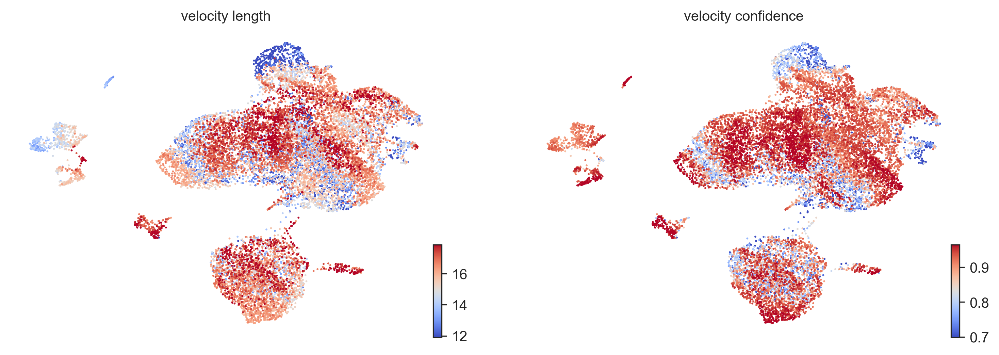

In [94]:
scv.tl.velocity_confidence(adata)

keys = 'velocity_length', 'velocity_confidence'  
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95], basis = 'umap_imputed',
                 dpi = 300, save = 'figures/scvelo_/by-timepoint/confidence.png')



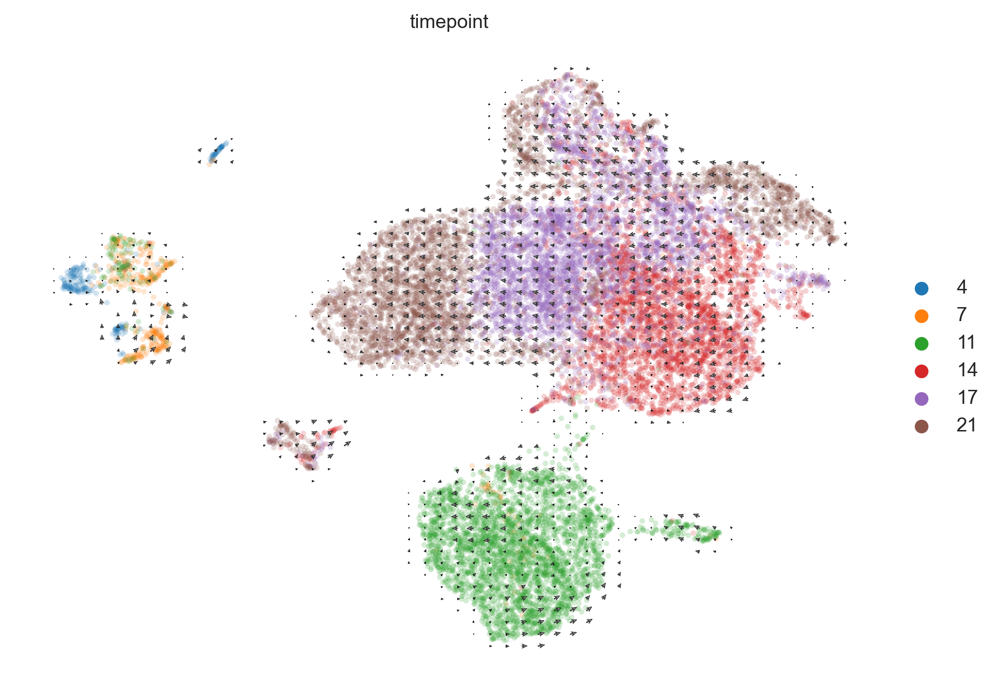

In [95]:
scv.pl.velocity_embedding_grid(adata, vkey='velocity',basis = 'umap_imputed', figsize = (8,6), legend_loc = 'on right',color = 'timepoint',
                              dpi = 300, save = 'figures/scvelo_/by-timepoint/timepoint_grid.png')


Let's save the data at this point.

In [16]:
adata.write_h5ad('../../out/RPM-time-series/adata_04_by-timepoint.h5ad')



In [17]:
adata = sc.read_h5ad('../../out/RPM-time-series/adata_04_by-timepoint.h5ad')



## Kinetic Rate Parameters

In [19]:
adata

AnnData object with n_obs × n_vars = 15138 × 19455
    obs: 'Diffusion Pseudotime', 'Monocle Pseudotime', 'Clusters', '_X', '_Y', 'batch', 'doublet_scores', 'predicted_doublets', 'timepoint', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'barcode', 'ireland_barcode', 'M', 'E', 'clusters_gradients', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'specialists_pca_diffdist', 'SCLC-Y_Score', 'SCLC-P_Score', 'SCLC-N_Score', 'SCLC-A2_Score', 'SCLC-A_Score', 'Phenotype', 'SCLC-A_Score_pos', 'SCLC-A2_Score_pos', 'SCLC-N_Score_pos', 'SCLC-P_Score_pos', 'SCLC-Y_Score_pos', 'arc_pheno', 'arc_aa_type', 'ParetoTI_specialists', 'subtype', 'subtype_labeled', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs', 'end_points', 'col', 'ctrp', 'absorbing'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'mean', 'std', 'n_cells', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_st

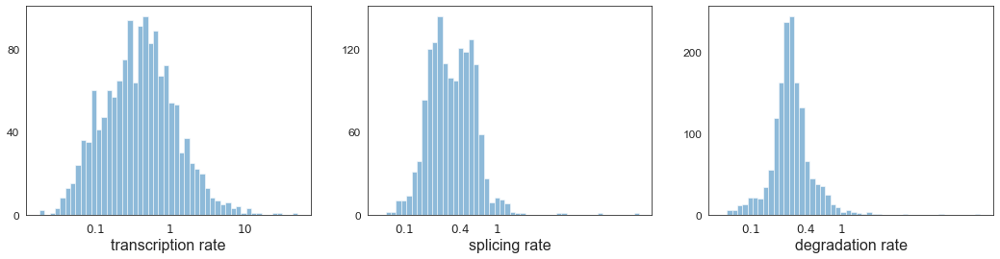

,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
Gene,,,,,,,,,,,,,,,,
Xkr4,0.683899,0.014802,0.004945,0.073303,39.637125,30.772888,0.729309,0.035550,3.215072e-21,0.0,0.0,0.219801,2.384638,0.123024,0.729908,9.857661
Snhg6,0.061348,0.304055,2.753860,0.170196,10.578994,0.133823,0.040115,0.354964,2.191679e-01,0.0,0.0,0.407861,0.122803,1.349608,1.093221,2.891894
Eloc,0.015085,2.264057,7.119534,0.363788,14.092117,0.034842,0.083007,1.125694,2.432976e-01,0.0,0.0,0.472492,0.272550,4.358558,0.871466,1.814109
Gm28154,0.030814,0.050048,4.624821,6.445398,2.177496,1.633795,0.004016,0.001352,1.202069e-04,0.0,0.0,0.000085,0.013709,0.008200,3.577514,0.043817
Rims1,0.364192,0.015643,0.015280,0.070707,20.755263,8.826750,0.277080,0.029194,4.204244e-15,0.0,0.0,0.422568,0.830750,0.127075,2.062038,7.642557


In [20]:
df = adata.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata, 'fit*', dropna=True).head()

In [21]:
df

,Accession,Chromosome,End,Start,Strand,gene_count_corr,mean,std,n_cells,fit_r2,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,velocity_genes
Gene,,,,,,,,,,,,,,,,,,,,,
Snhg6,ENSMUSG00000098234,1,9944118,9941959,-,0.0936,5.367617e-11,0.500659,7773,0.061348,...,0.354964,0.219168,0.0,0.0,0.407861,0.122803,1.349608,1.093221,2.891894,True
Eloc,ENSMUSG00000079658,1,16657042,16641725,-,0.1479,4.081713e-11,0.548869,8397,0.015085,...,1.125694,0.243298,0.0,0.0,0.472492,0.272550,4.358558,0.871466,1.814109,True
Bag2,ENSMUSG00000042215,1,33757795,33745484,-,0.0529,2.521015e-11,0.548159,8136,0.073364,...,0.431028,0.196022,0.0,0.0,0.418739,0.154526,1.615830,1.230508,1.651998,True
2010300C02Rik,ENSMUSG00000026090,1,37720085,37611677,-,-0.0197,-3.322197e-11,0.108470,415,0.044041,...,0.032266,0.206134,0.0,0.0,0.064426,0.102256,0.105718,1.062236,2.473877,True
Fhl2,ENSMUSG00000008136,1,43196984,43123074,-,0.0454,-2.079803e-10,0.554579,7587,0.305187,...,0.391435,0.229498,0.0,0.0,0.452134,0.704970,1.329705,1.034679,2.267797,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Map7d2,ENSMUSG00000041020,X,159498757,159414572,+,-0.0038,-2.202494e-11,0.300394,2401,0.411818,...,0.169168,0.163114,0.0,0.0,0.492732,0.169911,1.052123,1.261776,2.404550,True
Sh3kbp1,ENSMUSG00000040990,X,159978069,159627272,+,0.0840,-4.134290e-11,0.237546,1836,0.199954,...,0.082025,0.250570,0.0,0.0,0.218539,0.438036,0.231930,0.885919,2.333557,True
Map3k15,ENSMUSG00000031303,X,160123351,159988433,+,-0.0285,5.167862e-12,0.138414,403,0.888588,...,0.256393,0.214426,0.0,0.0,0.464255,1.078391,0.913024,0.544177,6.669571,True


In [4]:
df = scv.get_df(adata, 'fit*', dropna=True).sort_values('fit_likelihood', ascending=False)

In [19]:
df2 = df[ 'fit_likelihood'] #take only fit_like column
df2.index = df2.index.str.upper() #make index strs uppercase
df2.to_csv('rpm_FL_noheader_caps.csv', header=None, sep='\t') #save df to csv

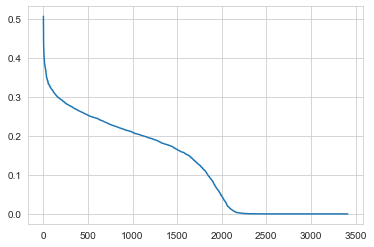

In [29]:
sns.set_style('whitegrid')
plt.plot(range(len(df.index)), df.fit_likelihood)
plt.savefig('./figures/scvelo_/fit_likelihoods_cdf.pdf')

In [54]:
for i in df.index:
    if df.loc[i, 'fit_likelihood'] > 0.3:
        print(i) 
    else: break

Scg3
Smc4
Tcerg1l
Lhfp
Fmn2
Ltbp1
Bspry
Galnt9
Cadps2
Anxa3
Esrp1
Hnrnpd
Knl1
Frmd5
Cdk1
Srrm4
Tox
Lrp11
Ncl
Aldh1a7
Epcam
Smc2
Top2a
Vwf
Galnt14
Ksr2
Gnao1
Wnk2
Esco2
Nebl
Nfkbia
Snrpf
Pex5l
Hmcn1
Mis18bp1
Dnajc6
Dner
Arfgef3
Ddx39
St14
Gxylt2
Dek
Scg5
Cnpy1
Prmt1
Syncrip
Dut
Rptoros
Nipal2
Ezh2
Myof
Diaph3
Mdh1
Shtn1
Klhl41
Cdca2
Ctnna2
Txnrd1
Prep
Cabp1
Me1
Prc1
Nexmif
Gpc3
Esd
Kif11
Kif20b
Cct3
Nusap1
Ncapd3
Phyhipl
Foxp2
Tpx2
Cct8
Nfix
Trappc6a
Eftud2
Nap1l1
Mcc
Tmem163
Kif15
Smpdl3b
Wdr43
Rab3b
Psmd1
Ric3
Unc13a
Anln
Aunip
Cenph
Npnt
Rad18
Rnf150
Srsf2
G2e3
Hells
Tgfb2
Aven
Arid5b
Neil3
Anxa2
Rspo2
Tk1
Sobp
Gsr
Prkcz
Mctp2
Hsp90ab1
Naa15
Abce1
Slc7a1
Arl6ip1
Zbtb20
Cenpf
Dpysl5
Ddx46
Cdcp1
Tomm40
Nucks1
Nol4
Cs
Prox1os
Ttll7
Vrk1
Tmpo
Pgbd5
Cenpk
Pus7
Kif4
Cks2
Rbm28
Eepd1
Tomm70a
Snu13
Idh2
Ube2q2
Myo1b
Ptprz1
Clspn
Tcerg1
Nomo1
Plaur
Pgd
Lamc1
Nop56
Heatr1
Ccn3
Fbn2
Pgls
Smc1a
Baz1a
Eif5
Gtf2f2
Brip1
Specc1
Tnfaip3
S100a6
Zbtb11
Exosc8
Plppr1
Nfkb1


In [ ]:
# https://maayanlab.cloud/Enrichr/enrich?dataset=f461d660431c17b04fc9b149b780d96a


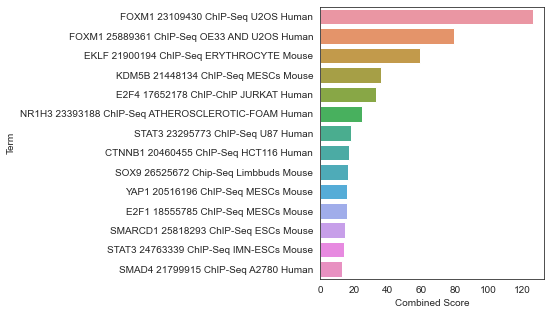

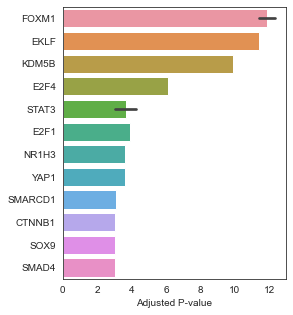

In [44]:
ChEA_df = pd.read_csv('ChEA_2016_table_fitlikelihoodgenes.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (4,5))
sns.barplot(x = sig['Combined Score'], 
            y = sig['Term'])
# plt.xticks(rotation = 90)
plt.savefig('./figures/velocity_top_likelihood_TFs_ChEA.pdf')

sig = sig.sort_values('Adjusted P-value')
plt.figure(figsize = (4,5))
sns.barplot(x = -np.log(sig['Adjusted P-value']), 
            y = [i.split(' ')[0] for i in sig['Term']])
plt.savefig('./figures/velocity_top_likelihood_TFs_ChEA_pval.pdf')


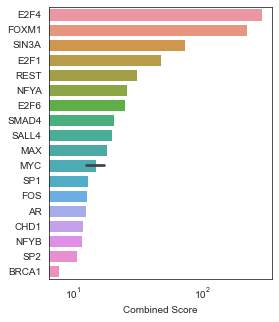

In [107]:
ChEA_df = pd.read_csv('ENCODE_and_ChEA_Consensus_TFs_from_ChIP-X_table_fitlikelihoodgenes.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (4,5))
sns.barplot(x = sig['Combined Score'], 
            y = [i.split(' ')[0] for i in sig['Term']])
plt.xscale('log')
# plt.xticks(rotation = 90)
plt.savefig('./figures/velocity_top_likelihood_TFs_Consensus.pdf')

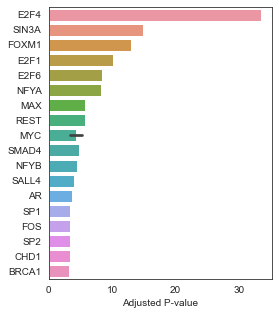

In [43]:
sig = sig.sort_values('Adjusted P-value')
plt.figure(figsize = (4,5))
sns.barplot(x = -np.log(sig['Adjusted P-value']), 
            y = [i.split(' ')[0] for i in sig['Term']])
plt.savefig('./figures/velocity_top_likelihood_TFs_Consensus_pval.pdf')

## CellRank

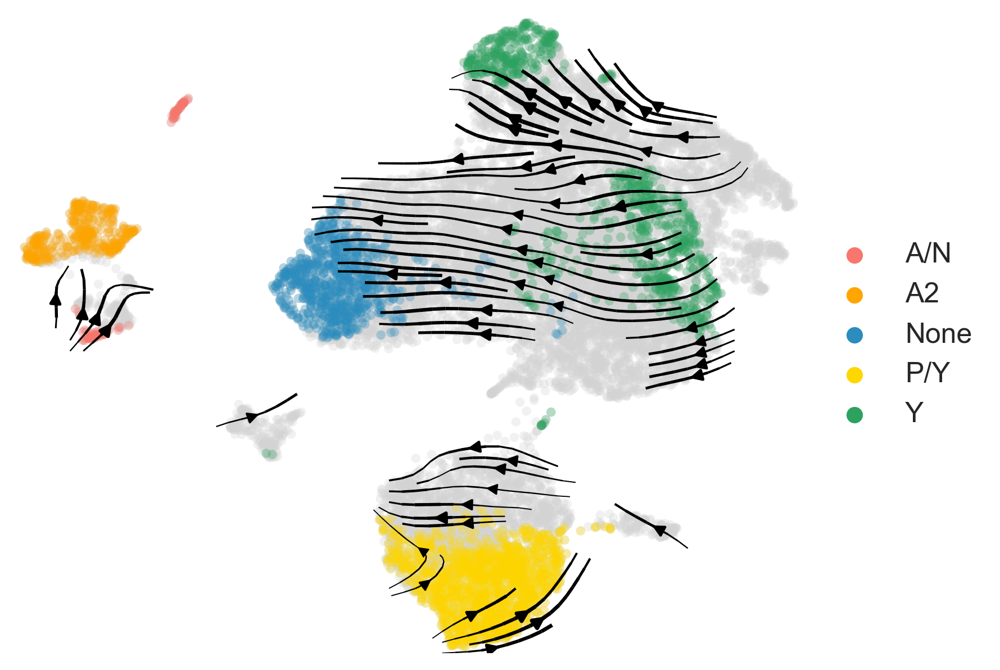

In [19]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_imputed", color = ['ParetoTI_specialists'], palette=['#F8766D','orange','#2b8cbe','gold','#2ca25f'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300, figsize = (6,5),
    # save = 'figures/scvelo_/by-timepoint/velocity-independent/subtypes_arcs_stream.png'
)

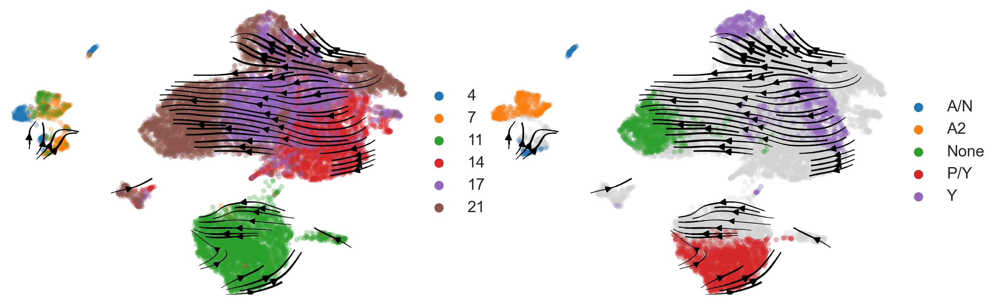

In [201]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap_imputed", color = ['timepoint', 'ParetoTI_specialists'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300,
    save = 'figures/scvelo_/by-timepoint/timepoint_arcs_stream.png'
)

saving figure to file figures/scvelo_/by-timepoint/top_gene_fits_subtypes.png


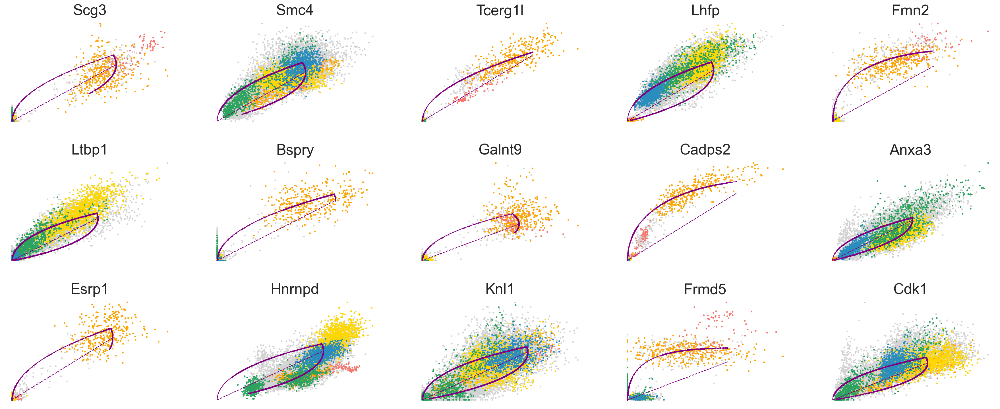

In [13]:
#Fit Genes
# top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index

scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False, color = 'ParetoTI_specialists', save = "figures/scvelo_/by-timepoint/top_gene_fits_subtypes.png",
               fontsize = 25,size = 30,
               dpi = 150)

In [33]:
adata.obsm['X_umap'] = adata.obsm['X_umap_imputed']

In [35]:
k = MyKernel(adata).compute_transition_matrix()
k.compute_transition_matrix()

Reading `adata.obs['Diffusion Pseudotime']`
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]


<MyKernel>

In [36]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/15138 [00:00<?, ?cell/s]

  0%|          | 0/15138 [00:00<?, ?cell/s]

<VelocityKernel>

In [37]:
combined_kernel = 0.8 * vk + 0.2* k
from cellrank.tl.estimators import GPCCA

g = GPCCA(combined_kernel)
g.compute_schur(n_components=20)
print(g)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000075e+00 -3.6798938460636205e-04 2.9751207824711091e-03 6.1223931848644816e-03 -3.1048248898490282e-03 1.9379684755453638e-02 -4.4454622850071762e-02 2.9467922446763602e-02 9.9597335115570694e-03 3.4937969536404621e-02 -2.8678541854750880e-03 -4.8106619469558114e-03 -3.6635900744453193e-02 -1.7822058401360152e-02 4.4177344732653423e-03 2.9695200201944123e-03 7.9184360159678391e-03 2.8345065960322824e-02 -2.5466933797333009e-02 1.0206726978241742e-02 -4.4290916965292054e-02 
0.0000000000000000e+00 9.9659705555622080e-01 -9.7745040655598651e-04 -5.2348809893639360e-04 -1.2990945637826344e-02 -7.0444707602800158e-03 7.4413850346243347e-03 -6.3970709109149437e-03 -3.3314809836710643e-03 -1.4772695280299708e-04 -4.7130002360642062e-02 9.8896097000358385e-04 6.4445372038531359e-03 3.1748005958655971e-03 -1.2280470848038787e-03 -8.5608950212518787e-04 -5.5072675989096875e-02 5.3827734094543764e-02 7.8521475613697062e-03 -1.60123045887

## Macrostates: timepoints

In [38]:
adata.obsm['X_umap'] = adata.obsm['X_umap_imputed']

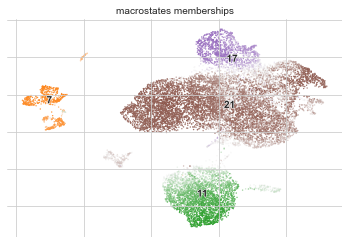

  0%|          | 0/4 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: 

In [39]:
g.compute_macrostates(cluster_key="timepoint") 
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [36]:
scv.tl.paga(
    adata,
    groups="timepoint",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="Diffusion Pseudotime",
)

running PAGA using priors: ['Diffusion Pseudotime', 'terminal_states_probs']
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:724: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  alpha=alpha,


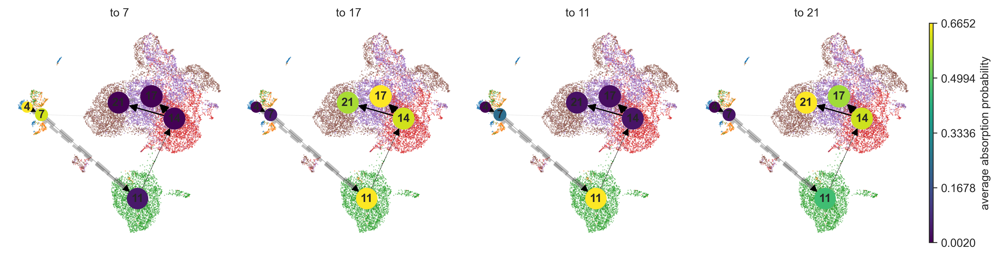

In [209]:
cr.pl.cluster_fates(
    adata,
    mode="paga",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300)#, save = './figures/scvelo_/by-timepoint/paga_timepoint.png')

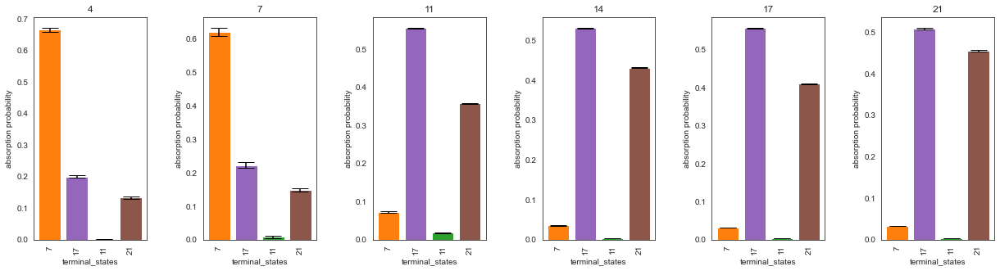

In [210]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed", ncols = 6, save = './figures/scvelo_/by-timepoint/paga_bar_timepoint.pdf')


## Macrostates: subtypes

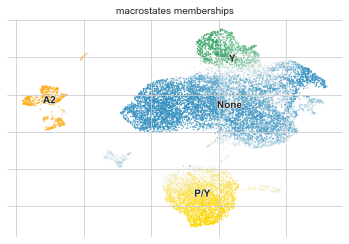

  0%|          | 0/4 [00:00<?, ?/s]

[0]PETSC ERROR: 

In [40]:
g.compute_macrostates(cluster_key="ParetoTI_specialists") #to change macrostates calcualted by archetype
g.plot_macrostates()
g.compute_terminal_states() 
g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [79]:
g.write('../../out/RPM-time-series/GPCCA')

In [43]:
drivers = g.compute_lineage_drivers(lineages=["None",'Y'], return_drivers=True)  #when running macrostates and terminal states by timepoint
drivers.sort_values(by="None_corr", ascending=False)
# g.plot_lineage_drivers("None", n_genes=15)

,None_corr,None_pval,None_qval,None_ci_low,None_ci_high,Y_corr,Y_pval,Y_qval,Y_ci_low,Y_ci_high
Gene,,,,,,,,,,
Phgdh,0.406999,0.0,0.0,0.393621,0.420205,-0.025823,1.485416e-03,2.873497e-03,-0.041736,-0.009897
Nt5dc2,0.377524,0.0,0.0,0.363781,0.391102,-0.107220,5.045818e-40,4.214959e-39,-0.122940,-0.091446
Rps2,0.371552,0.0,0.0,0.357739,0.385202,0.285360,1.665560e-285,1.105920e-283,0.270660,0.299926
S100a10,0.365411,0.0,0.0,0.351527,0.379134,0.498513,0.000000e+00,0.000000e+00,0.486446,0.510390
Dctpp1,0.364655,0.0,0.0,0.350763,0.378388,-0.276925,4.259290e-268,2.589515e-266,-0.291569,-0.262151
...,...,...,...,...,...,...,...,...,...,...
Krt7,-0.528832,0.0,0.0,-0.540212,-0.517260,-0.589794,0.000000e+00,0.000000e+00,-0.600086,-0.579307
Bex4,-0.534991,0.0,0.0,-0.546266,-0.523523,-0.580228,0.000000e+00,0.000000e+00,-0.590698,-0.569562
Bex2,-0.539435,0.0,0.0,-0.550633,-0.528043,-0.585658,0.000000e+00,0.000000e+00,-0.596028,-0.575094


In [81]:
drivers

,None_corr,None_pval,None_qval,None_ci_low,None_ci_high,Y_corr,Y_pval,Y_qval,Y_ci_low,Y_ci_high
Gene,,,,,,,,,,
Phgdh,0.406999,0.0,0.0,0.393621,0.420205,-0.025823,1.485416e-03,2.873497e-03,-0.041736,-0.009897
Nt5dc2,0.377524,0.0,0.0,0.363781,0.391102,-0.107220,5.045818e-40,4.214959e-39,-0.122940,-0.091446
Rps2,0.371552,0.0,0.0,0.357739,0.385202,0.285360,1.665560e-285,1.105920e-283,0.270660,0.299926
S100a10,0.365411,0.0,0.0,0.351527,0.379134,0.498513,0.000000e+00,0.000000e+00,0.486446,0.510390
Dctpp1,0.364655,0.0,0.0,0.350763,0.378388,-0.276925,4.259290e-268,2.589515e-266,-0.291569,-0.262151
...,...,...,...,...,...,...,...,...,...,...
Krt7,-0.528832,0.0,0.0,-0.540212,-0.517260,-0.589794,0.000000e+00,0.000000e+00,-0.600086,-0.579307
Bex4,-0.534991,0.0,0.0,-0.546266,-0.523523,-0.580228,0.000000e+00,0.000000e+00,-0.590698,-0.569562
Bex2,-0.539435,0.0,0.0,-0.550633,-0.528043,-0.585658,0.000000e+00,0.000000e+00,-0.596028,-0.575094


In [82]:
drivers.to_csv('../../out/RPM-time-series/drivers.csv')

In [7]:
drivers = pd.read_csv('../../out/RPM-time-series/drivers.csv', index_col=0)

In [115]:
for i in drivers.sort_values(by="None_corr", ascending=False).index[0:40]:
    print(i)
#https://maayanlab.cloud/Enrichr/enrich?dataset=e2be46d36f2d42c226ef6eef1856ca48 X
# https://maayanlab.cloud/Enrichr/enrich?dataset=1c6442e396836fd9187091b4fa587083 Y

Phgdh
Nt5dc2
Rps2
S100a10
Dctpp1
Tuba1b
Hist1h1b
Cks1b
Anxa5
Pclaf
Eno1
Npm1
Atad2
Stmn1
Hmgb1
Nme2
Galk1
Exosc8
Rpl8
Tk1
Top2a
Rfc4
Tubb5
Birc5
Hist1h4d
Erh
Set
Mki67
Smc4
Cdkn2a
Mcm7
Lsm2
Hist1h2ae
Gcat
Smc2
Ranbp1
Siva1
Rfc5
Dek
Gmnn


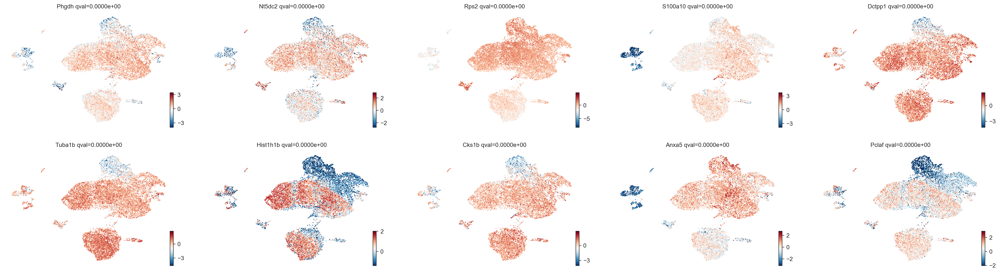

In [57]:
sns.set_style('white')
g.plot_lineage_drivers("None", n_genes=10, cmap = 'RdBu_r', ncols = 5, dpi = 200,
                      save ='./figures/scvelo_/by-timepoint/X_drivers.png')

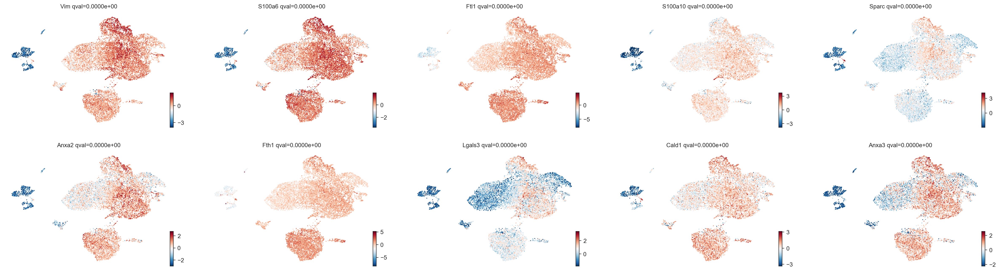

In [58]:
g.plot_lineage_drivers("Y", n_genes=10, cmap = 'RdBu_r', ncols = 5, dpi = 200,
                      save ='./figures/scvelo_/by-timepoint/Y_drivers.png')


In [81]:
y_genes = ['LGALS1','VIM','GSTP1','ANXA1','IFITM3','CNN2','FSTL1','TPM2','YAP1','CRIM1','MRC2','CAV1','GPX8','MAGEA4','MICA','AHNAK','TNFRSF10B','OSMR','EMP1','HOXC10','MSRB3','AXL','MYL9','SLPI']
# 

y_sig_drivers = drivers.loc[[i.capitalize() for i in y_genes if i.capitalize() in drivers.index]].loc[
    drivers['Y_qval'] < 0.05].loc[
    drivers['Y_corr'] > 0]


In [116]:
y_sig_drivers

,None_corr,None_pval,None_qval,None_ci_low,None_ci_high,Y_corr,Y_pval,Y_qval,Y_ci_low,Y_ci_high
Gene,,,,,,,,,,
Lgals1,-0.009685,2.334593e-01,3.221013e-01,-0.025611,0.006246,0.380802,0.000000e+00,0.000000e+00,0.367099,0.394340
Vim,0.220854,5.482167e-168,2.264449e-166,0.205647,0.235954,0.650250,0.000000e+00,0.000000e+00,0.640960,0.659351
Gstp1,0.042842,1.335674e-07,4.109685e-07,0.026931,0.058732,0.111146,6.680578e-43,5.937444e-42,0.095384,0.126851
Anxa1,-0.096514,1.041238e-32,8.769387e-32,-0.112272,-0.080708,0.265764,4.878534e-246,2.735213e-244,0.250896,0.280507
Ifitm3,0.039694,1.029517e-06,2.961154e-06,0.023779,0.055589,0.215455,1.026237e-159,3.361186e-158,0.200212,0.230594
Cnn2,-0.069496,1.094871e-17,5.788240e-17,-0.085332,-0.053625,0.262186,3.387444e-239,1.830631e-237,0.247289,0.276960
Fstl1,0.107305,4.387375e-40,4.302237e-39,0.091531,0.123024,0.090635,5.048998e-29,3.229069e-28,0.074813,0.106412
Tpm2,-0.051687,1.960101e-10,7.329188e-10,-0.067562,-0.035786,0.059140,3.236114e-13,1.202877e-12,0.043251,0.075000
Yap1,0.060878,6.443581e-14,2.910607e-13,0.044991,0.076734,0.061089,5.280808e-14,2.032406e-13,0.045203,0.076944


saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Lgals1.png


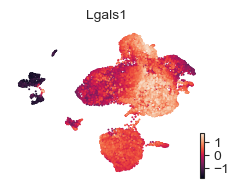

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Vim.png


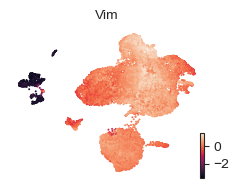

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Gstp1.png


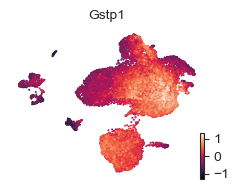

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Anxa1.png


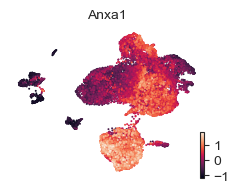

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Ifitm3.png


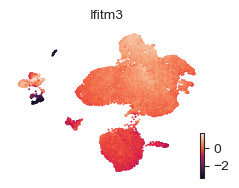

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Cnn2.png


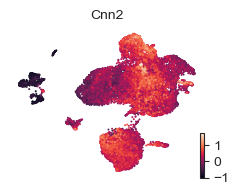

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Fstl1.png


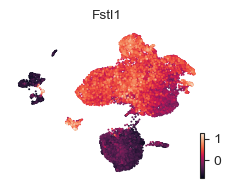

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Tpm2.png


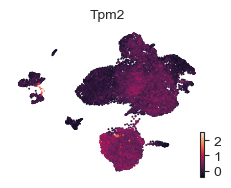

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Yap1.png


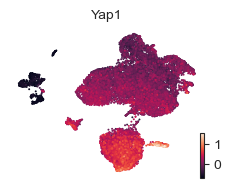

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Cav1.png


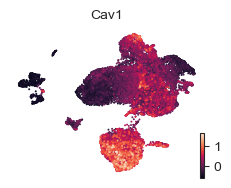

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Gpx8.png


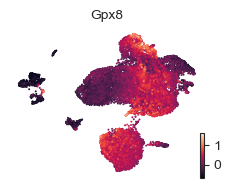

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Ahnak.png


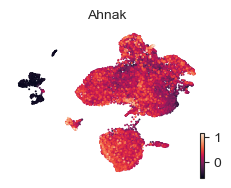

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Tnfrsf10b.png


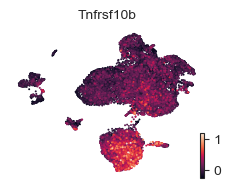

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Osmr.png


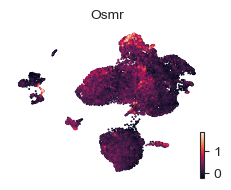

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Emp1.png


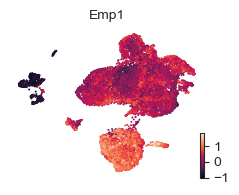

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Msrb3.png


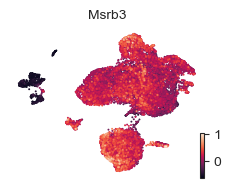

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Axl.png


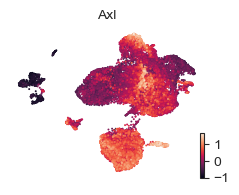

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Myl9.png


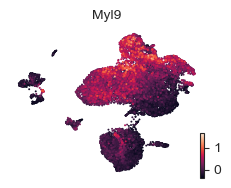

saving figure to file ./figures/scvelo_/by-timepoint/velocity-independent/Slpi.png


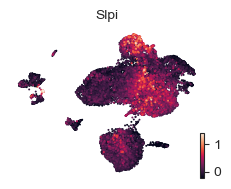

In [90]:
for i in y_sig_drivers.index:
    scv.pl.umap(adata, color =  i, smooth=True, dpi = 100, figsize=(2.5,2), save = f'./figures/scvelo_/by-timepoint/velocity-independent/{i}.png')


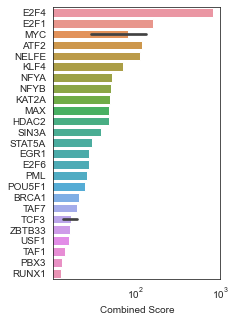

In [114]:
ChEA_df = pd.read_csv('ENCODE_and_ChEA_Consensus_TFs_from_ChIP-X_table_X_drivers.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (3,5))
sns.barplot(x = sig['Combined Score'], 
            y = [i.split(' ')[0] for i in sig['Term']])
plt.xscale('log')
plt.xlim(0,1000)
# plt.xticks(rotation = 90)
plt.savefig('./figures/X_drivers_Consensus.pdf')

In [214]:
ChEA_df = pd.read_csv('./Y-drivers/ChEA_2016_table_Y_drivers.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)

# [print(i.split(' ')[0]) for i in sig['Term']]

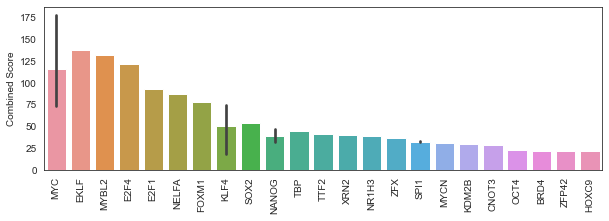

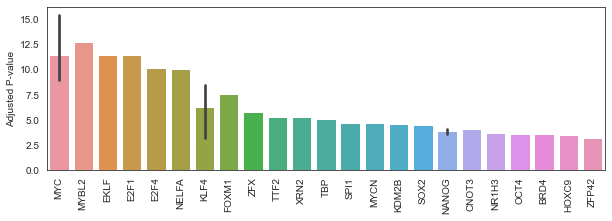

In [118]:
ChEA_df = pd.read_csv('ChEA_2016_table_X_drivers.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (10,3))
sns.barplot(y = sig['Combined Score'], 
            x = [i.split(' ')[0] for i in sig['Term']])
plt.xticks(rotation = 90)
plt.savefig('./figures/X_drivers_TFs_ChEA.pdf')

sig = sig.sort_values('Adjusted P-value')
plt.figure(figsize = (10,3))
sns.barplot(y = -np.log(sig['Adjusted P-value']), 
            x = [i.split(' ')[0] for i in sig['Term']])
plt.xticks(rotation = 90)

plt.savefig('./figures/X_drivers_ChEA_pval.pdf')

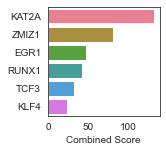

In [105]:
ChEA_df = pd.read_csv('ENCODE_and_ChEA_Consensus_TFs_from_ChIP-X_table_Y_drivers.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (2,2))
sns.barplot(x = sig['Combined Score'], 
            y = [i.split(' ')[0] for i in sig['Term']],
           palette=sns.husl_palette(6))#, s=.6))
# plt.xscale('log')
# plt.xticks(rotation = 90)
plt.savefig('./figures/Y_drivers_Consensus.pdf')

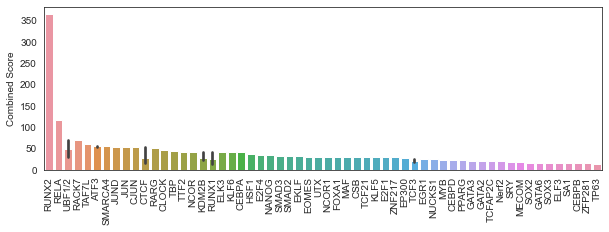

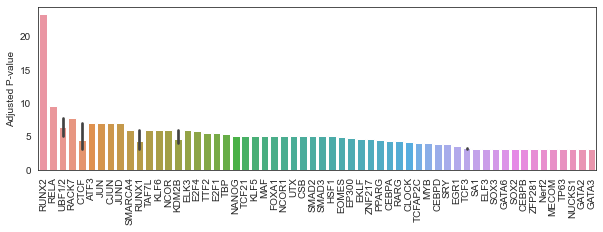

In [93]:
ChEA_df = pd.read_csv('ChEA_2016_table_Y_drivers.txt', delimiter='\t')
sig = ChEA_df.loc[ChEA_df['Adjusted P-value'] < 0.05].sort_values('Combined Score', ascending = False)
plt.figure(figsize = (10,3))
sns.barplot(y = sig['Combined Score'], 
            x = [i.split(' ')[0] for i in sig['Term']])
plt.xticks(rotation = 90)
plt.savefig('./figures/Y_drivers_TFs_ChEA.pdf')

sig = sig.sort_values('Adjusted P-value')
plt.figure(figsize = (10,3))
sns.barplot(y = -np.log(sig['Adjusted P-value']), 
            x = [i.split(' ')[0] for i in sig['Term']])
plt.xticks(rotation = 90)

plt.savefig('./figures/Y_drivers_ChEA_pval.pdf')

In [219]:
Y_drivers = pd.read_csv('./Y-drivers/Y-DRIVERS-MOUSE.txt', delimiter='\t')
X_drivers = pd.read_csv('./X-drivers/X-drivers', delimiter='\t', header=None)


In [222]:
drivers = pd.read_csv('./Combined-drivers/string_interactions_short (5).tsv', delimiter='\t')
drivers

,#node1,node2,node1_string_id,node2_string_id,homology,experimentally_determined_interaction,database_annotated,automated_textmining,combined_score
0,Atf2,Gata2,10090.ENSMUSP00000107641,10090.ENSMUSP00000015197,0,0.085,0.378,0.074,0.426
1,Atf2,Brca1,10090.ENSMUSP00000107641,10090.ENSMUSP00000017290,0,0.454,0.634,0.000,0.791
2,Atf2,Pou5f1,10090.ENSMUSP00000107641,10090.ENSMUSP00000025271,0,0.443,0.188,0.000,0.528
3,Atf2,Rela,10090.ENSMUSP00000107641,10090.ENSMUSP00000025867,0,0.139,0.588,0.245,0.708
4,Atf2,Atf3,10090.ENSMUSP00000107641,10090.ENSMUSP00000027941,0,0.473,0.000,0.000,0.473
...,...,...,...,...,...,...,...,...,...
371,Taf1,Tbp,10090.ENSMUSP00000098895,10090.ENSMUSP00000124317,0,0.803,0.800,0.894,0.995
372,Taf7,Taf7l,10090.ENSMUSP00000065645,10090.ENSMUSP00000009740,0,0.000,0.540,0.000,0.540
373,Taf7,Tbp,10090.ENSMUSP00000065645,10090.ENSMUSP00000124317,0,0.953,0.800,0.579,0.995
374,Taf7l,Tbp,10090.ENSMUSP00000009740,10090.ENSMUSP00000124317,0,0.759,0.540,0.772,0.972


In [223]:
drivers.loc[(drivers['#node1'].isin(['Nelfa','Nelfe','Hoxc9','Pbx3']))]

,#node1,node2,node1_string_id,node2_string_id,homology,experimentally_determined_interaction,database_annotated,automated_textmining,combined_score
213,Hoxc9,Pbx3,10090.ENSMUSP00000001706,10090.ENSMUSP00000045281,0,0.540,0.0,0.318,0.672
311,Nelfa,Nelfe,10090.ENSMUSP00000030993,10090.ENSMUSP00000134272,0,0.932,0.8,0.451,0.991


In [224]:
drivers_short = drivers.drop([213,311])

In [225]:
central_counts = drivers_short['#node1'].value_counts()

In [226]:
import networkx as nx
Graphtype = nx.Graph()
G = nx.from_pandas_edgelist(df = drivers_short, source = '#node1', target= 'node2')


In [227]:
names = []
color = []
central = []
for n in G.nodes():
    if n in Y_drivers['mapped gene'].values:

        if n in X_drivers[2].values:
            names.append('Both')
            color.append("#beaed4") #both
        else:
            names.append('Y')
            color.append("#a6cee3") #y
    elif n in X_drivers[2].values:
        names.append('X')
        color.append("#fbb4ae")
    else: 
        names.append('None')
        color.append("lightgrey")
    try:
        central.append(central_counts[n])
    except KeyError: central.append(0)


In [228]:
names_dict = {i:{'name':j, 'color': c, 'counts':k} for i,j,c,k in zip(G.nodes, names,color, central)}

In [229]:
nx.set_node_attributes(G, names_dict)

In [205]:
top = [n for n in G.nodes() if G.nodes[n]['name'] == 'Blue']

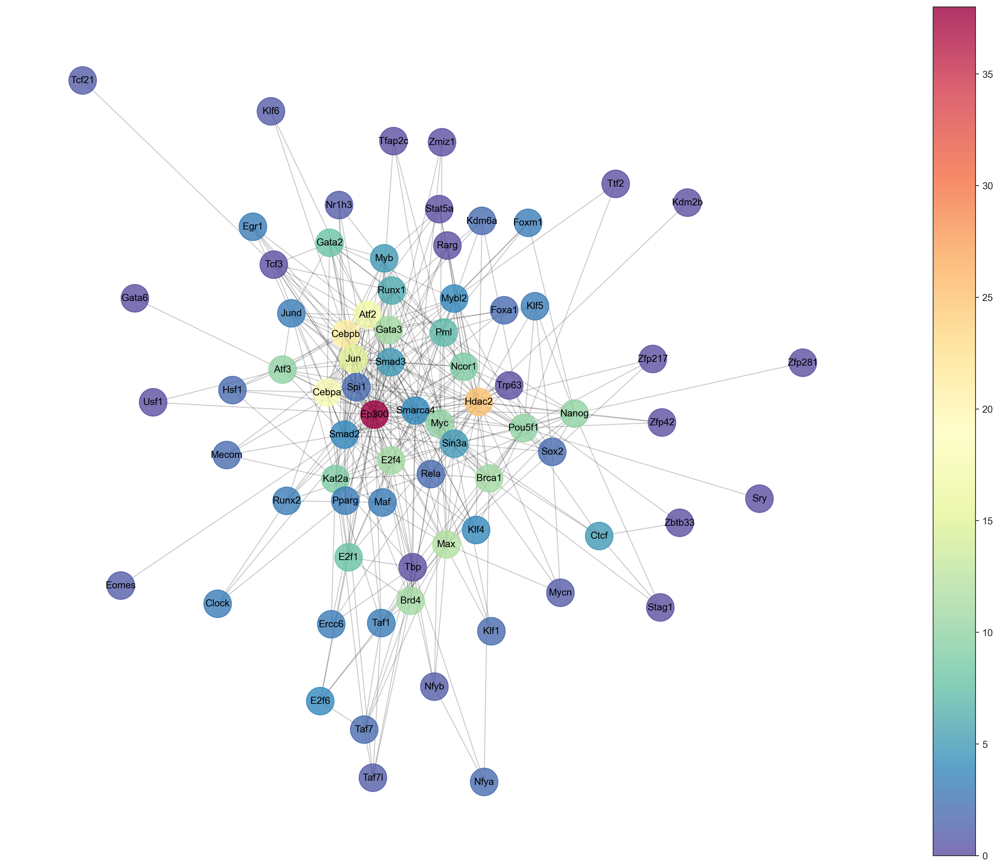

In [232]:
import matplotlib.pyplot as plt
# create number for each group to allow use of colormap
from itertools import count
# get unique groups
groups = set(nx.get_node_attributes(G,'counts').values())
mapping = dict(zip(sorted(groups),count()))
nodes = G.nodes()
colors = [mapping[G.nodes[n]['counts']] for n in nodes]
plt.figure(figsize = (20,16), dpi = 300)
# drawing nodes and edges separately so we can capture collection for colobar
# pos = nx.spring_layout(G)
nx.draw_networkx_labels(G, pos,font_size = 10)
ec = nx.draw_networkx_edges(G, pos, alpha=0.2)
nc = nx.draw_networkx_nodes(G, pos, nodelist=nodes, node_color=[G.nodes[n]['counts'] for n in nodes],node_size=800,alpha = .8,
                      cmap = 'Spectral_r', 
                     )
plt.colorbar(nc)
plt.axis('off')
plt.savefig('./figures/drivers_central.pdf')

plt.show()

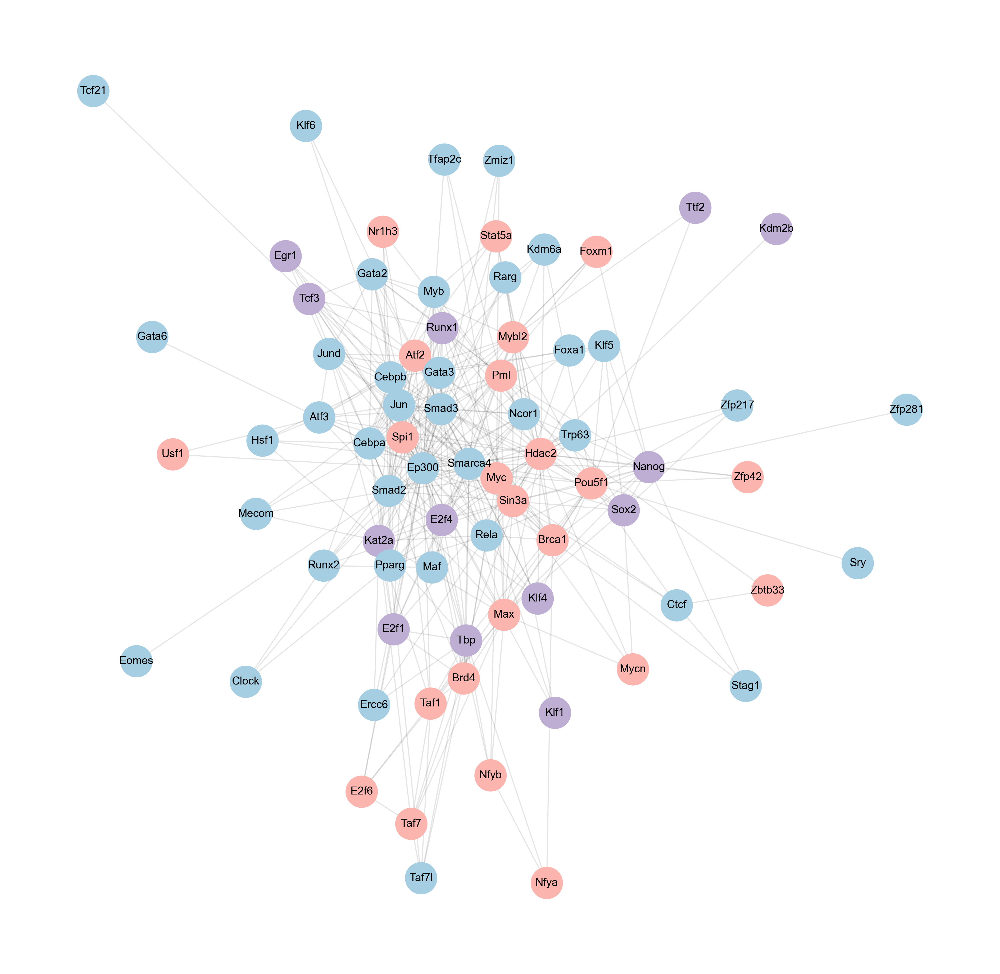

In [233]:
plt.figure(figsize = (16,16), dpi = 300)
# drawing nodes and edges separately so we can capture collection for colobar
nx.draw_networkx_labels(G, pos,font_size = 10)
ec = nx.draw_networkx_edges(G, pos, alpha=0.1)
nc = nx.draw_networkx_nodes(G, pos, nodelist=nodes, node_color=[G.nodes[n]['color'] for n in nodes],node_size=800,alpha = 1,
                     )
plt.axis('off')
plt.savefig('./figures/drivers_X_Y_both.pdf')

plt.show()

saving figure to file ./figures/scvelo_/by-timepoint/macrostates.png


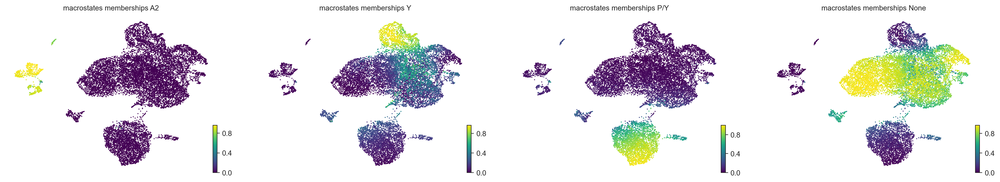

In [65]:
g.plot_macrostates(same_plot=False, dpi = 200, save = './figures/scvelo_/by-timepoint/macrostates.png')


saving figure to file ./figures/scvelo_/by-timepoint/macrostates_discrete.png


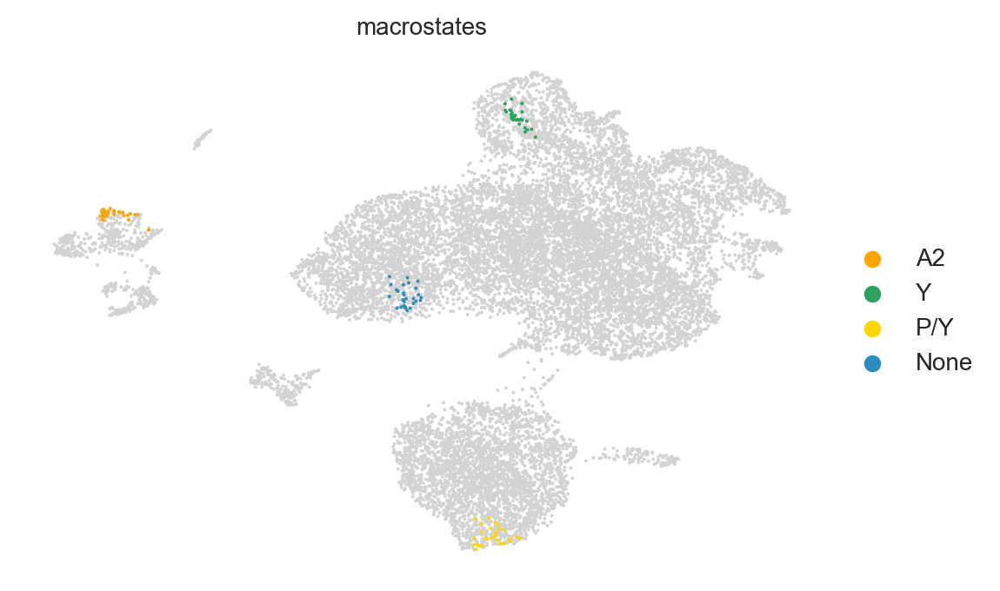

In [67]:
g.plot_macrostates(discrete = True, dpi = 200, save = './figures/scvelo_/by-timepoint/macrostates_discrete.png', legend_loc='on right')


saving figure to file ./figures/scvelo_/by-timepoint/absorb_prob.png


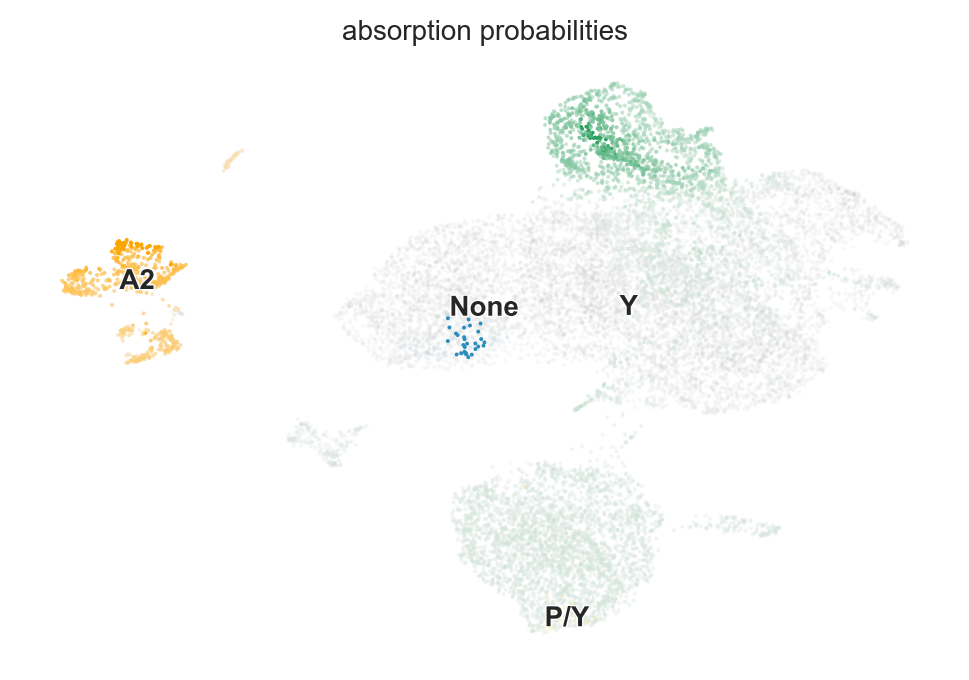

In [69]:
g.plot_absorption_probabilities(dpi = 200, save = './figures/scvelo_/by-timepoint/absorb_prob.png')

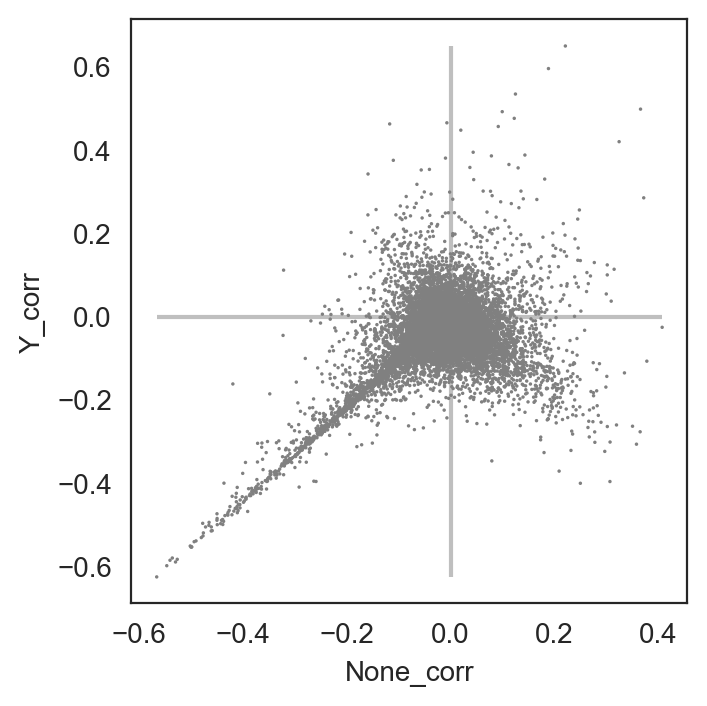

In [78]:
g.plot_lineage_drivers_correlation(lineage_x='None',lineage_y='Y', dpi = 200, save = './figures/scvelo_/by-timepoint/X_Y_corr_drivers.png')

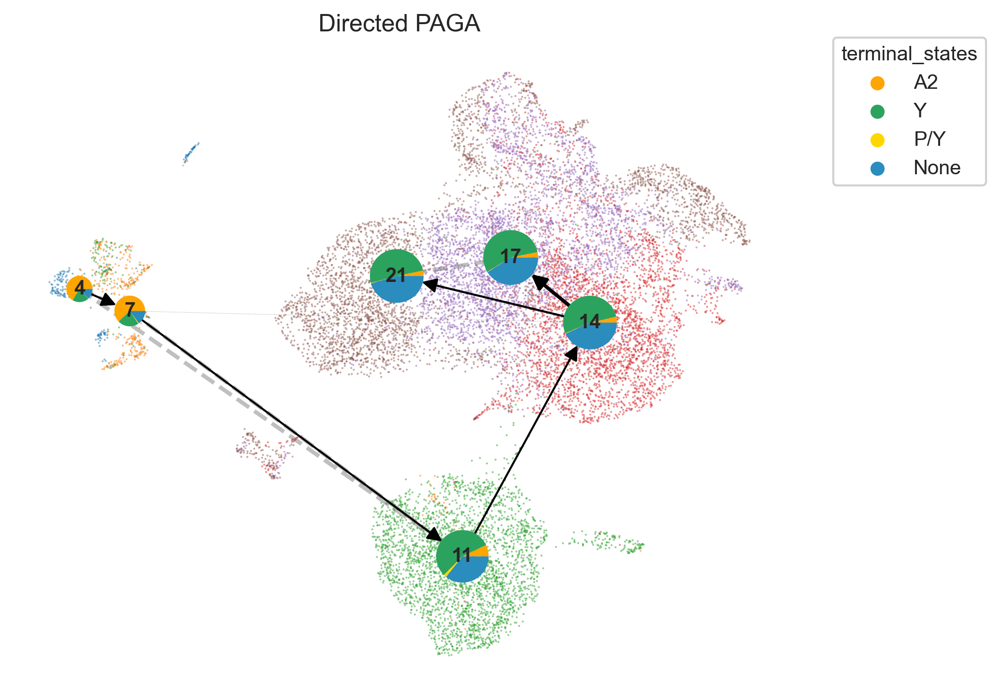

In [38]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="timepoint",
    basis="umap_imputed",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=4,
    edge_width_scale=1,
    min_edge_width=1,
    dpi = 300,
    title="Directed PAGA",figsize = (6, 5), save = './figures/scvelo_/by-timepoint/paga_subtype.pdf')

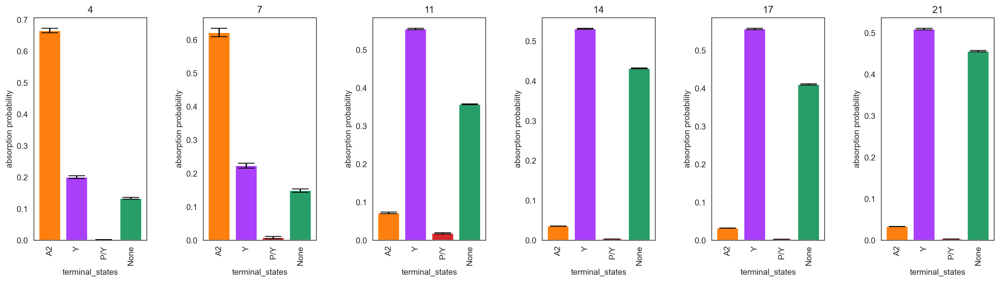

In [108]:
cr.pl.cluster_fates(
    adata,
    mode="bar",
    cluster_key="timepoint",
    basis="umap_imputed",ncols = 6, save = './figures/scvelo_/by-timepoint/paga_bar_subtype.png', dpi = 300)


In [39]:
adata.uns['coarse_fwd'] = None #there isn't an implementation to write to h5ad with an anndata object in attributes of another anndata

adata.write_h5ad('../../out/RPM-time-series/adata_04_by-timepoint_CR.h5ad')


In [4]:
adata = cr.read('../../out/RPM-time-series/adata_04_by-timepoint_CR.h5ad')


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `cellrank.tl.read` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  """Entry point for launching an IPython kernel.


In [11]:
sc.tl.rank_genes_groups(adata, groupby='ParetoTI_specialists', groups=['None'])

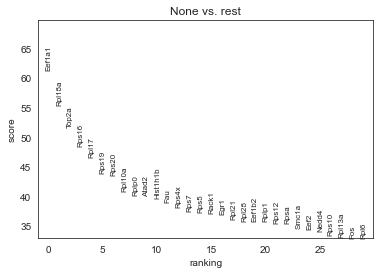

In [13]:
sc.pl.rank_genes_groups(adata, n_genes=30)

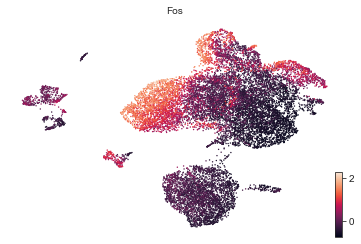

In [21]:
scv.pl.umap(adata, color =  'Fos', smooth=True
           
           )

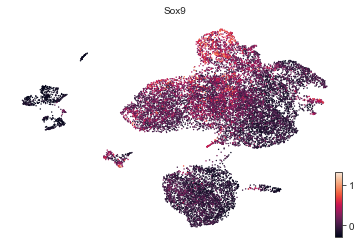

In [20]:
scv.pl.umap(adata, color =  'Sox9', smooth=True)


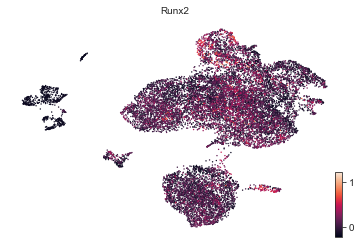

In [48]:
scv.pl.umap(adata, color =  'Runx2', smooth=True)


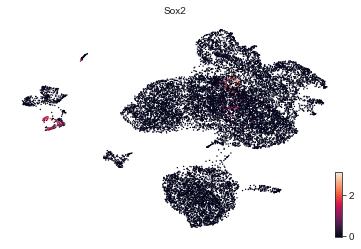

In [121]:
scv.pl.umap(adata, color =  'Sox2', smooth=True)


# CTRP

In [2]:
adata = cr.read('../../out/RPM-time-series/adata_04_by-timepoint_CR.h5ad')


/Users/smgroves/Documents/anaconda3/envs/mazebox_env/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `cellrank.tl.read` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  """Entry point for launching an IPython kernel.


In [5]:
k = MyKernel(adata).compute_transition_matrix()
k.compute_transition_matrix()

Reading `adata.obs['Diffusion Pseudotime']`
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]
Accessing `.pseudotime`:  [0.08062416 0.07080161 0.0694875  ... 0.13437028 0.12651777 0.10692273]


<MyKernel>

In [6]:
vk = VelocityKernel(adata)
vk.compute_transition_matrix()

  0%|          | 0/15138 [00:00<?, ?cell/s]

  0%|          | 0/15138 [00:00<?, ?cell/s]

<VelocityKernel>

In [7]:
combined_kernel = 0.8 * vk + 0.2* k
# from cellrank.tl.estimators import GPCCA

# g = GPCCA(combined_kernel)
# g.compute_schur(n_components=20)
# print(g)

In [8]:
combined_kernel.compute_transition_matrix()

((0.8 * <VelocityKernel>) + (0.2 * <MyKernel>))

In [11]:
combined_kernel.transition_matrix

<15138x15138 sparse matrix of type '<class 'numpy.float64'>'
	with 667652 stored elements in Compressed Sparse Row format>

In [9]:
mb.ps.ctrp_simplified(adata,distance_basis='X_pca_imputed', T = combined_kernel.transition_matrix)



Eigenvalues:  [1.]
    identified 1 end points
[[1.25420943e-03 2.08618619e-02 1.76163284e-02 ... 1.10023357e-03
  6.23797955e-03 6.86999620e-04]
 [1.25321471e-03 2.08726446e-02 1.76251703e-02 ... 1.09937827e-03
  6.24071867e-03 6.86465293e-04]
 [1.26750130e-03 2.09810986e-02 1.77149992e-02 ... 1.12631772e-03
  6.21970277e-03 6.84731971e-04]
 ...
 [1.20134990e-04 1.75937081e-02 1.68993143e-02 ... 1.27191074e-04
  4.23824311e-02 7.54776259e-05]
 [5.87502120e-04 5.59225626e-04 4.76311207e-04 ... 2.69882250e-04
  3.02258532e-04 3.37219839e-04]
 [1.71650399e-03 1.20426634e-02 1.06513752e-02 ... 1.30621387e-03
  5.60871089e-03 7.56860837e-04]]


<AxesSubplot:title={'center':'ctrp'}>

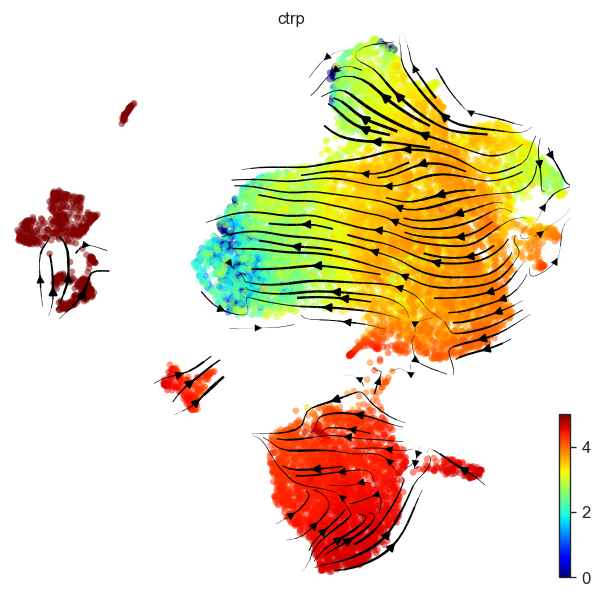

In [10]:
scv.pl.velocity_embedding_stream(adata, color='ctrp', show=False, color_map='jet', alpha=0.5, basis='umap_imputed', dpi=120,
                    zorder=1,figsize=(6,6), vmax = 5)

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'None'),
  Text(1, 0, 'Generalist'),
  Text(2, 0, 'Y'),
  Text(3, 0, 'P/Y'),
  Text(4, 0, 'A2'),
  Text(5, 0, 'A/N')])

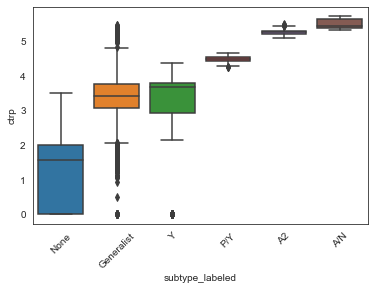

In [13]:
from statannot import add_stat_annotation
df = adata.obs[['subtype_labeled','ctrp']].pivot(columns='subtype_labeled')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index
plt.figure(figsize=(6,4))
ax = sns.boxplot(data = adata.obs, x='subtype_labeled',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                order = sorted_index)
plt.xticks(rotation = 45)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Archetype 2'),
  Text(1, 0, 'Archetype 6'),
  Text(2, 0, 'Generalist'),
  Text(3, 0, 'Archetype 3'),
  Text(4, 0, 'Archetype 1'),
  Text(5, 0, 'Archetype 4'),
  Text(6, 0, 'Archetype 5')])

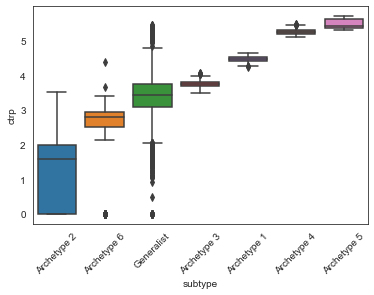

In [14]:
from statannot import add_stat_annotation
df = adata.obs[['subtype','ctrp']].pivot(columns='subtype')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index
plt.figure(figsize=(6,4))
ax = sns.boxplot(data = adata.obs, x='subtype',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                order = sorted_index)
plt.xticks(rotation = 45)

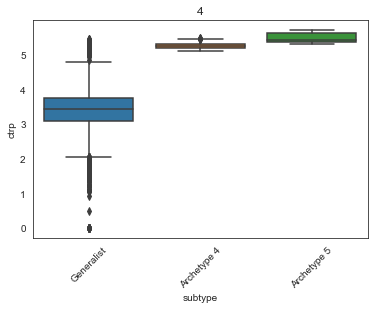

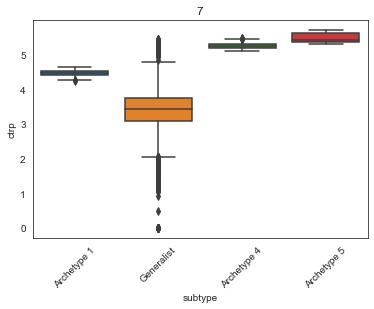

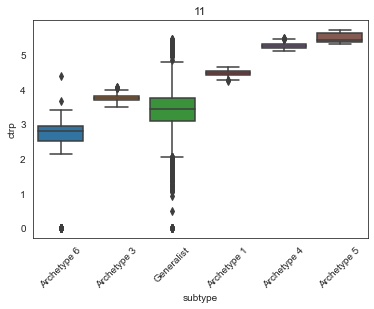

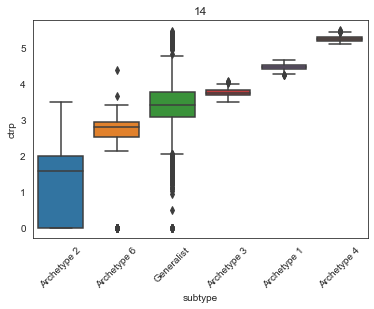

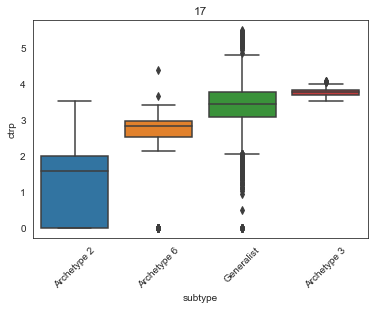

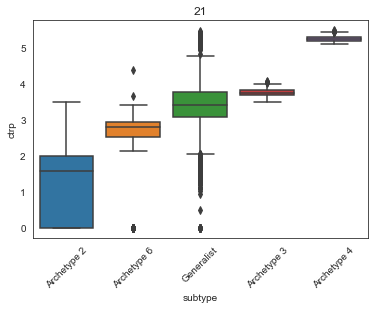

In [18]:
from statannot import add_stat_annotation
for day in adata.obs.timepoint.cat.categories:
    
    df = adata[adata.obs.timepoint == day].obs[['subtype','ctrp']].pivot(columns='subtype')
    df.columns = df.columns.droplevel(0)
    sorted_index = df.median().sort_values().index
    plt.figure(figsize=(6,4))
    ax = sns.boxplot(data = adata.obs, x='subtype',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                    order = sorted_index)
    plt.xticks(rotation = 45)
    plt.title(day)
    plt.show()

<Graph object, directed, with 0 vertices and 0 edges, at 0x7fc3095b7b50>